# Analysis of sales data and prediction for the next month

> We have data on the number of orders for the last 2 years for 10 articles.

```The task is to analyze this data and create a sales plan for January.```

## Preparing instruments and loading data

In [4]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import catboost as cb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, root_mean_squared_error

from statsmodels.tsa.stattools import acf, pacf

import skforecast
from skforecast.recursive import ForecasterEquivalentDate
# from skforecast.recursive import ForecasterRecursive
# from skforecast.model_selection import TimeSeriesFold, OneStepAheadFold
# from skforecast.model_selection import bayesian_search_forecaster
# from skforecast.model_selection import backtesting_forecaster
# from skforecast.feature_selection import select_features
# from skforecast.preprocessing import RollingFeatures

In [3]:
df = pd.read_csv('wb_orders.csv', parse_dates=['date', 'last_change_date', 'created_at', 'updated_at', 'cancel_dt'], dayfirst=True)
df.head()

,date,last_change_date,total_price,discount_percent,warehouse_name,oblast,nm_id,category,brand,is_cancel,cancel_dt,created_at,updated_at,order_type
0,2024-10-12 05:24:00,2024-10-12,2329,17,Краснодар,Ростовская область,905559214,Товары для животных,e129baf5351375dd,False,NaT,2024-11-12 18:11:00,2024-11-12 18:11:00,Клиентский
1,2024-10-12 10:45:00,2024-10-12,2329,17,Казань,Самарская область,905559214,Товары для животных,e129baf5351375dd,False,NaT,2024-11-12 18:11:00,2024-11-12 18:11:00,Клиентский
2,2024-10-12 09:24:00,2024-10-12,2329,17,Казань,Свердловская область,905559214,Товары для животных,e129baf5351375dd,False,NaT,2024-11-12 18:11:00,2024-11-12 18:11:00,Клиентский
3,2024-10-12 11:53:00,2024-10-12,2329,17,Электросталь,Тверская область,905559214,Товары для животных,e129baf5351375dd,False,NaT,2024-11-12 18:11:00,2024-11-12 18:11:00,Клиентский
4,2024-10-05 11:14:00,2024-10-12,2322,21,Казань,Красноярский край,905559214,Товары для животных,e129baf5351375dd,True,2024-10-12,2024-11-12 18:11:00,2024-11-12 18:11:00,Клиентский


In [5]:
# info about data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80142 entries, 0 to 80141
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   date              80142 non-null  datetime64[ns]
 1   last_change_date  80142 non-null  datetime64[ns]
 2   total_price       80142 non-null  object        
 3   discount_percent  80142 non-null  int64         
 4   warehouse_name    80142 non-null  object        
 5   oblast            77178 non-null  object        
 6   nm_id             80142 non-null  int64         
 7   category          80142 non-null  object        
 8   brand             80142 non-null  object        
 9   is_cancel         80142 non-null  bool          
 10  cancel_dt         3902 non-null   datetime64[ns]
 11  created_at        79606 non-null  datetime64[ns]
 12  updated_at        80142 non-null  datetime64[ns]
 13  order_type        65572 non-null  object        
dtypes: bool(1), datetime64

In [6]:
# total_price in format "object", fix it
df_fixed = (
    df
    .assign(
        total_price = lambda x: x['total_price'].str.replace(',', '.').astype('float64'),
        nm_id = lambda x: x['nm_id'].abs() 
           )
    .sort_values('date')
    .drop(['created_at', 'updated_at'], axis = 1)
    .reset_index(drop = True)
    .assign(nm_id = lambda x: x['nm_id'].astype('category'),
           brand = lambda x: x['brand'].astype('category'),
           category = lambda x: x['category'].astype('category'))
    .query('(last_change_date < "2024-12-01") and (last_change_date >= "2022-08-01")')
    .query('(nm_id != 44403861) or (last_change_date > "2023-07-31")', engine = 'python')
)
df_fixed.info()

<class 'pandas.core.frame.DataFrame'>
Index: 79865 entries, 1 to 80119
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   date              79865 non-null  datetime64[ns]
 1   last_change_date  79865 non-null  datetime64[ns]
 2   total_price       79865 non-null  float64       
 3   discount_percent  79865 non-null  int64         
 4   warehouse_name    79865 non-null  object        
 5   oblast            76905 non-null  object        
 6   nm_id             79865 non-null  category      
 7   category          79865 non-null  category      
 8   brand             79865 non-null  category      
 9   is_cancel         79865 non-null  bool          
 10  cancel_dt         3860 non-null   datetime64[ns]
 11  order_type        65329 non-null  object        
dtypes: bool(1), category(3), datetime64[ns](3), float64(1), int64(1), object(3)
memory usage: 5.8+ MB


In [106]:
df_fixed.describe(include=np.number)

,total_price,discount_percent
count,79865.000000,79865.000000
mean,1341.367731,12.539911
std,757.994634,10.323248
min,239.000000,0.000000
25%,572.000000,0.000000
50%,1645.000000,15.000000
75%,1978.000000,20.000000
max,3664.000000,46.000000


In [107]:
df_fixed.describe(include='category')

,nm_id,category,brand
count,79865,79865,79865
unique,10,1,5
top,905559214,Товары для животных,89edf2b23057232f
freq,12258,79865,25730


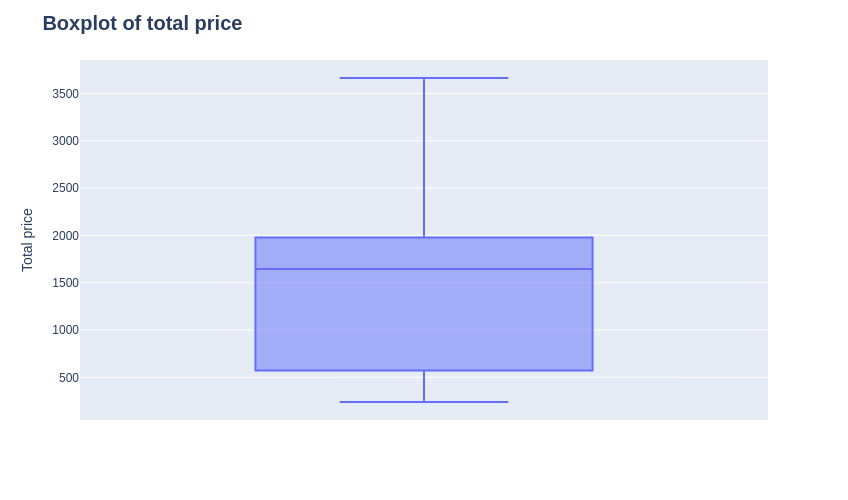

In [108]:
fig = px.box(
    df_fixed,
    y = 'total_price'
    
)
fig.update_layout(
    title = dict(
        text = 'Boxplot of total price',
        font = dict(
            size = 20,
            weight = 'bold'
        )
    ),
    height = 500,
    yaxis = dict(
        title = dict(
            text = 'Total price'
        )
    )
)
fig.show()

## Distribution of purchases by month

In [7]:
# get all months and nm_id from start to end of observation
all_months = (
    pd.date_range(start = df_fixed['last_change_date'].min(), 
              end = (df_fixed['last_change_date'].max()), 
              freq="M")
    .to_period('M')
    .to_frame()
    .reset_index(drop=True)
    .rename({0: 'sales_month'}, axis = 1)
)
nm_id_unique = pd.DataFrame(
    df_fixed
    ['nm_id'].unique(), columns = ['nm_id']
)
months_n_id = (
    all_months
    .join(nm_id_unique, how = 'cross', sort = True)
)
months_n_id

,sales_month,nm_id
0,2022-08,83054245
1,2022-08,678167538
2,2022-08,126373749
3,2022-08,95166060
4,2022-08,304773881
...,...,...
275,2024-11,440376223
276,2024-11,905559214
277,2024-11,879714109
278,2024-11,811003631


In [8]:
# number of sales including returns
df_agg = (
    df_fixed
    .assign(sales_month = lambda x: x['last_change_date'].dt.to_period('M'),
           revenue = lambda x: x['total_price'] * (1 - x['discount_percent'] / 100) * ~x['is_cancel'])
    .groupby(['sales_month', 'nm_id'], observed=False).agg({'nm_id': 'count', 'is_cancel': 'sum', 'revenue': 'sum'})
    .assign(count = lambda x: x['nm_id'] - x['is_cancel'])
    [['revenue', 'count']]
    
)
df_agg

revenue  count
sales_month nm_id                      
2022-08     44403861        0.00      0
            83054245   591821.00    410
            95166060    17304.00     56
            126373749  460578.45    261
            304773881  190300.55    395
...                          ...    ...
2024-11     440376223  230171.95    269
            678167538  296689.50    127
            811003631  205543.14    116
            879714109  166673.76    324
            905559214  657949.41    354

[280 rows x 2 columns]

In [9]:
all_revenue_by_month_id = (
    months_n_id
    .merge(df_agg, on = ['sales_month', 'nm_id'], how = 'left' )
)
all_revenue_by_month_id

,sales_month,nm_id,revenue,count
0,2022-08,83054245,591821.00,410
1,2022-08,678167538,500631.30,361
2,2022-08,126373749,460578.45,261
3,2022-08,95166060,17304.00,56
4,2022-08,304773881,190300.55,395
...,...,...,...,...
275,2024-11,440376223,230171.95,269
276,2024-11,905559214,657949.41,354
277,2024-11,879714109,166673.76,324
278,2024-11,811003631,205543.14,116


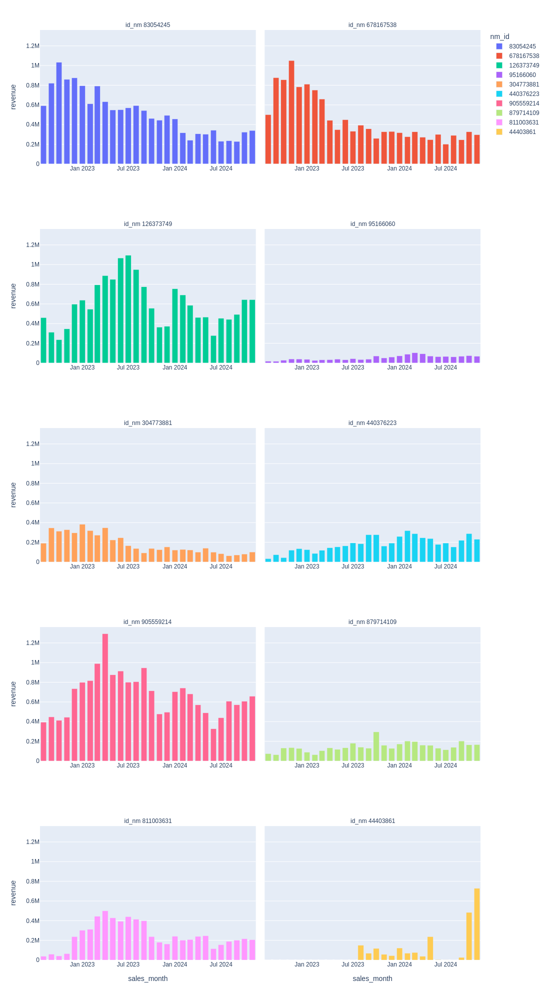

In [12]:
fig = px.bar(
    all_revenue_by_month_id.assign(sales_month = lambda x: x['sales_month'].astype('string')),
    x = 'sales_month',
    y = 'revenue',
    color = 'nm_id',
    facet_col = 'nm_id',
    facet_col_wrap = 2
)
fig.for_each_annotation(lambda x: x.update(text=f'id_nm {x.text.split("=")[-1]}'))
fig.update_layout(
    height = 2000
)
fig.for_each_xaxis(lambda x: x.update(
    showticklabels = True
))
fig.show()

In [13]:
df_revenue = (
    df_fixed
    .assign(revenue = lambda x: x['total_price'] * (1 - x['discount_percent'] / 100) * ~x['is_cancel'])
    .query('revenue != 0')
    # .set_index('last_change_date')
)
df_revenue.head()

,date,last_change_date,total_price,discount_percent,warehouse_name,oblast,nm_id,category,brand,is_cancel,cancel_dt,order_type,revenue
1,2022-07-31,2022-08-01,1661.0,15,Коледино,Омская,83054245,Товары для животных,89edf2b23057232f,False,NaT,NaN,1411.85
2,2022-07-31,2022-08-01,1602.0,15,Коледино,Москва,678167538,Товары для животных,89edf2b23057232f,False,NaT,NaN,1361.70
4,2022-07-31,2022-08-01,2039.0,15,Коледино,Московская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15
5,2022-07-31,2022-08-01,2039.0,15,Коледино,Челябинская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15
6,2022-07-31,2022-08-01,2039.0,15,Коледино,Иркутская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15


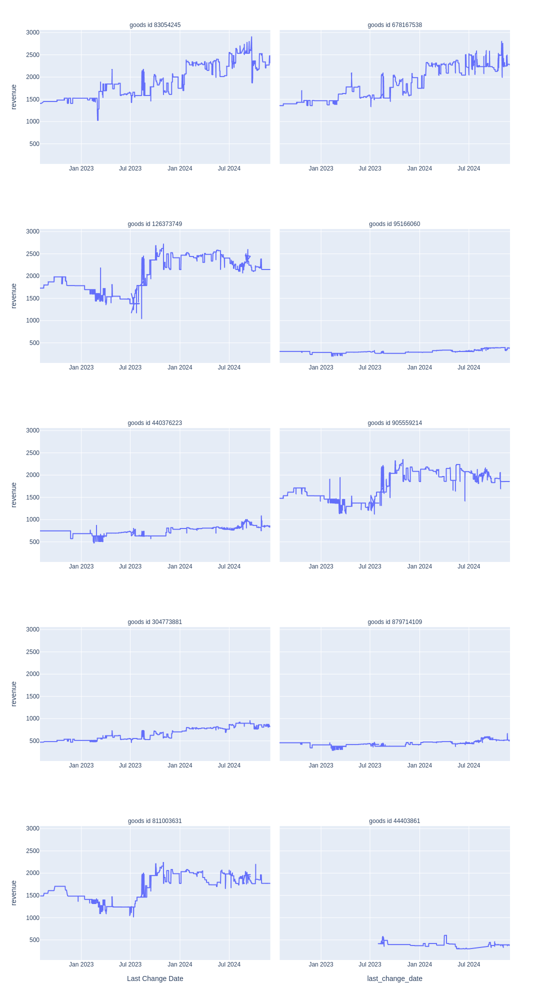

In [22]:
fig = px.line(
    df_revenue, 
    x = 'last_change_date',
    y = 'revenue',
    facet_col = 'nm_id',
    facet_col_wrap = 2
)

fig.update_layout(
    height = 2000,
    width = 1100,
    xaxis = dict(
        title_text = 'Last Change Date'
    )
)
fig.for_each_xaxis(lambda x: x.update(showticklabels = True))
fig.for_each_annotation(lambda x: x.update(text = f'goods id {x.text.split('=')[1]}'))

fig.show()

## Annual, weekly seasonality

In [23]:
df_revenue_month_weekday = (
    df_revenue
    .assign(month = lambda x: x['last_change_date'].dt.month,
           weekday = lambda x: x['last_change_date'].dt.weekday + 1,
           year = lambda x: x['last_change_date'].dt.year)
    .set_index('last_change_date')
)
df_revenue_month_weekday.head()

,date,total_price,discount_percent,warehouse_name,oblast,nm_id,category,brand,is_cancel,cancel_dt,order_type,revenue,month,weekday,year
last_change_date,,,,,,,,,,,,,,,
2022-08-01,2022-07-31,1661.0,15,Коледино,Омская,83054245,Товары для животных,89edf2b23057232f,False,NaT,NaN,1411.85,8,1,2022
2022-08-01,2022-07-31,1602.0,15,Коледино,Москва,678167538,Товары для животных,89edf2b23057232f,False,NaT,NaN,1361.70,8,1,2022
2022-08-01,2022-07-31,2039.0,15,Коледино,Московская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15,8,1,2022
2022-08-01,2022-07-31,2039.0,15,Коледино,Челябинская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15,8,1,2022
2022-08-01,2022-07-31,2039.0,15,Коледино,Иркутская,126373749,Товары для животных,e129baf5351375dd,False,NaT,NaN,1733.15,8,1,2022


## Seasonality for all goods

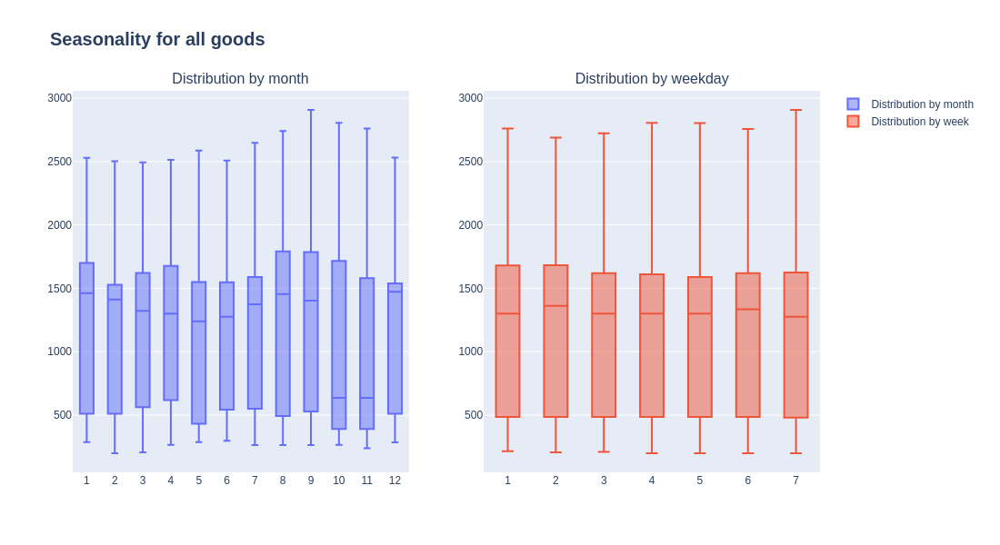

In [24]:
fig = make_subplots(1, 2, subplot_titles = ['Distribution by month', 
                                       'Distribution by weekday'
                                      ])

fig.add_traces(go.Box(x = df_revenue_month_weekday['month'],
                     y = df_revenue_month_weekday['revenue'],
                     name = 'Distribution by month'
                     ), 
              cols = 1,
              rows = 1
              )
fig.add_traces(go.Box(
    x = df_revenue_month_weekday['weekday'],
    y = df_revenue_month_weekday['revenue'],
    name = 'Distribution by week'
), 
              cols = 2,
              rows = 1)


fig.update_layout(
    xaxis1 = dict(
        tickmode = 'array',
        tickvals = [*range(1, 13)],
        ticktext = [*range(1, 13)]
    ),
    xaxis2 = dict(
        tickmode = 'array',
        tickvals = [*range(1, 8)],
        ticktext = [*range(1, 8)]
    ),
    height = 600,
    title = dict(
        text = 'Seasonality for all goods',
        font = dict(
            size = 20,
            weight = 'bold'
        )
    )
)
fig.show()

## Seasonality for every nm_id

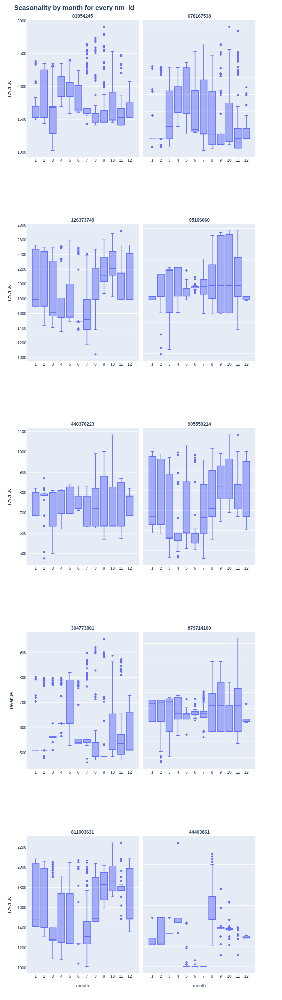

In [17]:
fig = px.box(
    df_revenue_month_weekday,
    x = 'month',
    y = 'revenue',
    facet_col = 'nm_id',
    facet_col_wrap = 2,
)

fig.update_traces(width = 0.8)
fig.for_each_annotation(lambda x: x.update(text = x.text.split('=')[1], font_size = 14, font_weight = 'bold'))
fig.update_layout(
    title = dict(
        text = 'Seasonality by month for every nm_id',
        font = dict(
            size = 20,
            weight = 'bold'
        )
    ),
    height = 3000
)
fig.update_yaxes(matches=None)
fig.update_xaxes(
    showticklabels = True,
    tickmode = 'array',
    tickvals = [*range(1, 13)],
    ticktext = [*range(1, 13)]
)
fig.show()

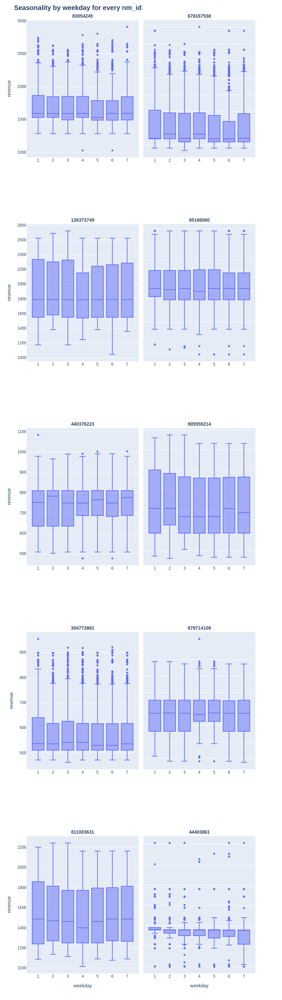

In [18]:
fig = px.box(
    df_revenue_month_weekday,
    x = 'weekday',
    y = 'revenue',
    facet_col = 'nm_id',
    facet_col_wrap = 2,
)

fig.update_traces(width = 0.8)
fig.for_each_annotation(lambda x: x.update(text = x.text.split('=')[1], font_size = 14, font_weight = 'bold'))
fig.update_layout(
    title = dict(
        text = 'Seasonality by weekday for every nm_id',
        font = dict(
            size = 20,
            weight = 'bold'
        )
    ),
    height = 3000
)
fig.update_yaxes(matches=None)
fig.update_xaxes(
    showticklabels = True,
    tickmode = 'array',
    tickvals = [*range(1, 8)],
    ticktext = [*range(1, 8)]
)
fig.show()